#### Loading data

In [35]:
# import packages
import pandas as pd
import numpy as np

import seaborn as sns
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap

In [36]:
# loading training and validation data to be splitted and analyzed as a pandas Dataframe
tvs = pd.read_csv('ML-CUP22-TR.csv', skiprows=6, header=0,
      names= ['exemples', 'input_1', 'input_2', 'input_3', 'input_4', 'input_5', 'input_6', 'input_7', 'input_8', 
      'input_9', 'target_1', 'target_2'], 
      index_col= ['exemples'])

# loading it in a numpy array skipping the first 7 rows
tvs_array = np.loadtxt('ML-CUP22-TR.csv', skiprows=6, delimiter=',')

#### Manipulating data

In [37]:
# visualizing infos about our Dataframe
tvs.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1492 entries, 1 to 1492
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   input_1   1492 non-null   float64
 1   input_2   1492 non-null   float64
 2   input_3   1492 non-null   float64
 3   input_4   1492 non-null   float64
 4   input_5   1492 non-null   float64
 5   input_6   1492 non-null   float64
 6   input_7   1492 non-null   float64
 7   input_8   1492 non-null   float64
 8   input_9   1492 non-null   float64
 9   target_1  1492 non-null   float64
 10  target_2  1492 non-null   float64
dtypes: float64(11)
memory usage: 139.9 KB


We note that there are no lacking entries, there are 1492 exemples each one made up of 9 inputs and we have 2 target outputs.

In [38]:
# just to see if it functions: print out some rows and columns
tvs.loc[[2,4], :]

,input_1,input_2,input_3,input_4,input_5,input_6,input_7,input_8,input_9,target_1,target_2
exemples,,,,,,,,,,,
2,-0.888962,0.711473,-0.480023,0.748175,-0.981763,1.765482,-0.445018,1.719143,-1.09625,18.88552,-28.377440
4,0.630938,-0.295533,1.379162,-0.041045,-0.250695,0.025003,0.143915,0.861455,0.87954,10.25682,-30.017064


#### Data Visualization

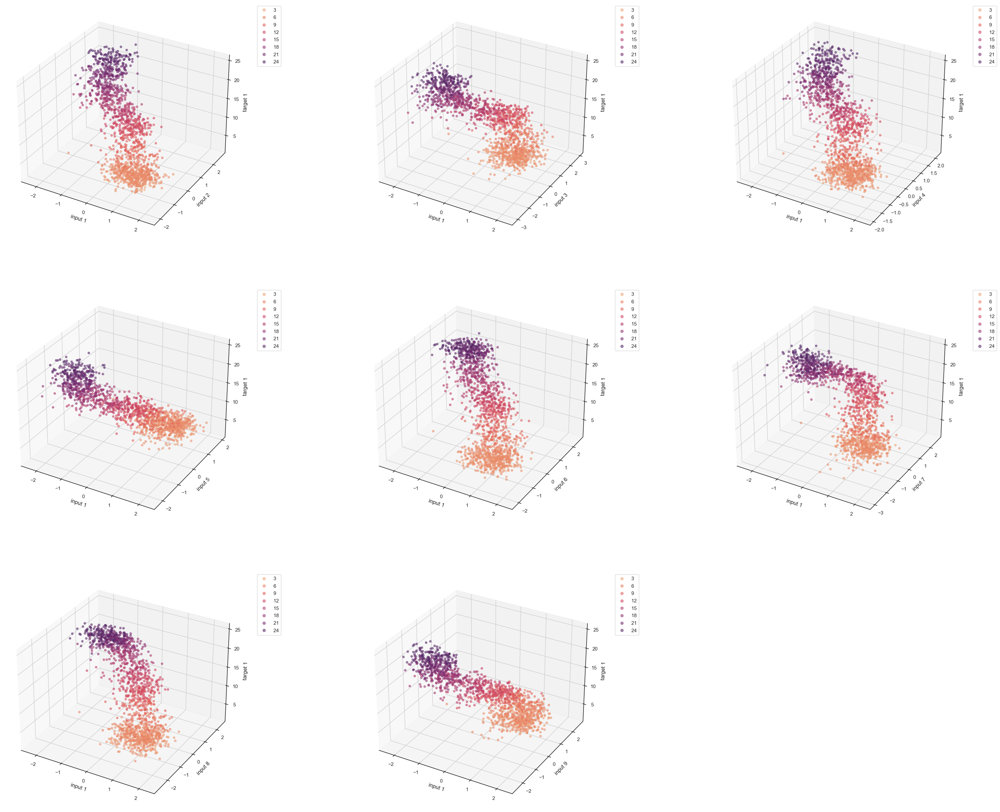

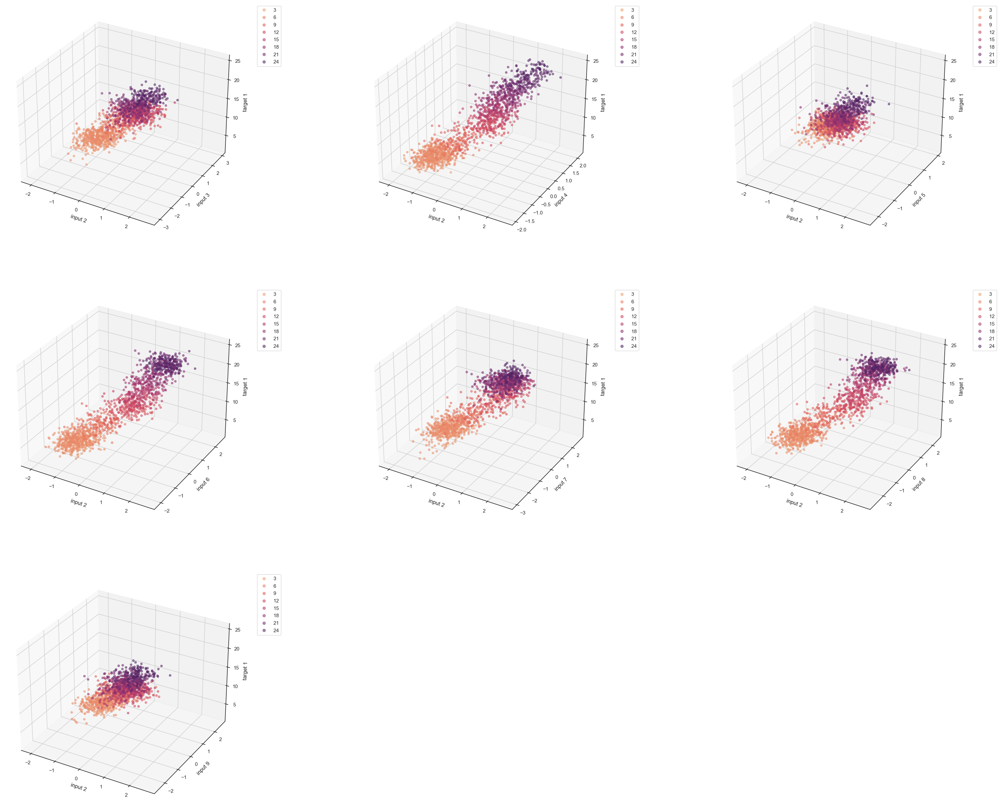

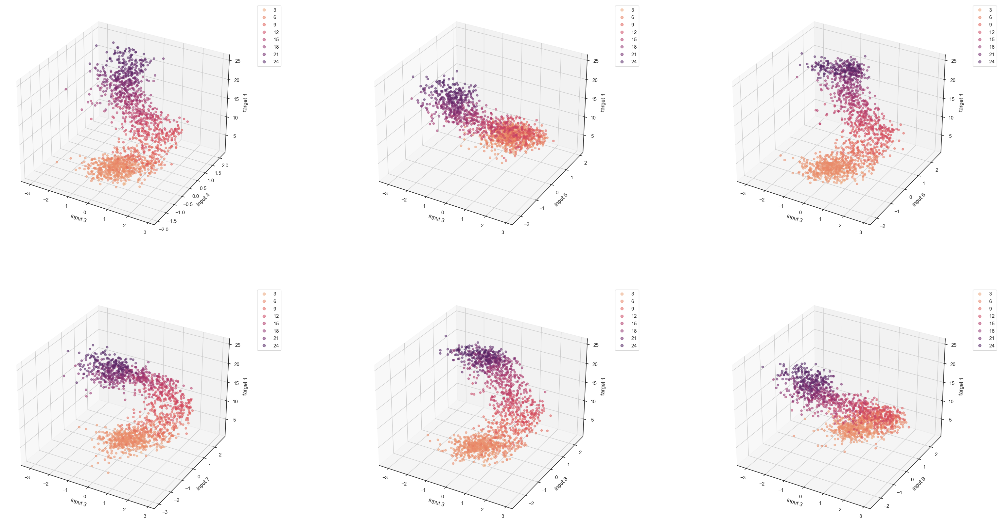

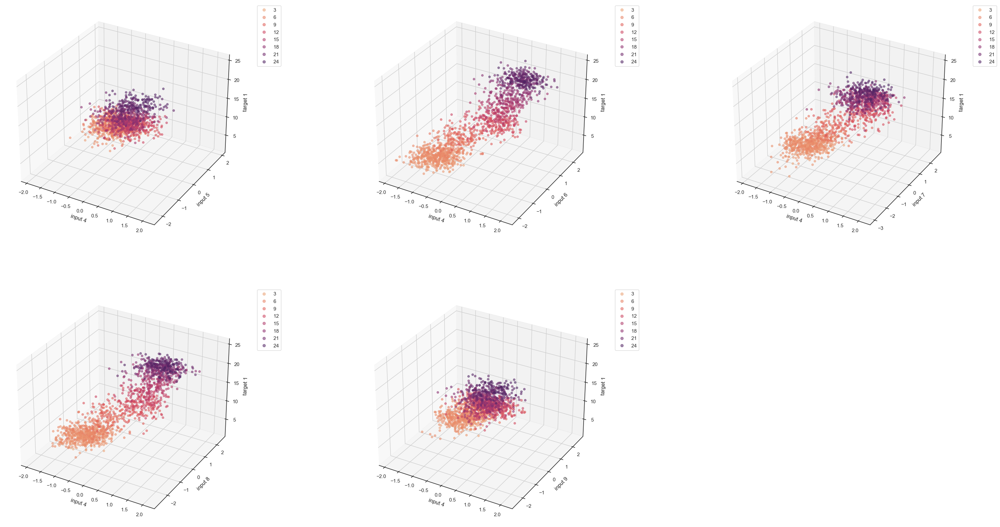

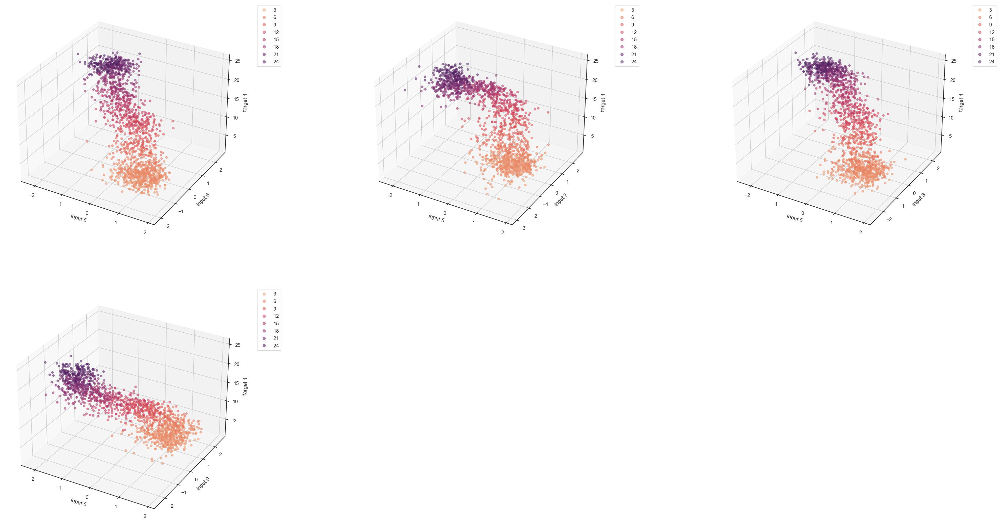

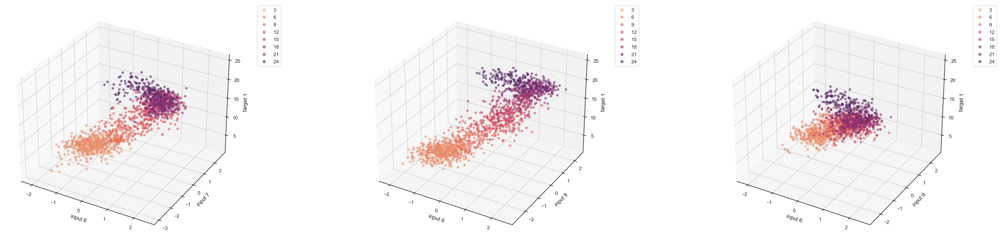

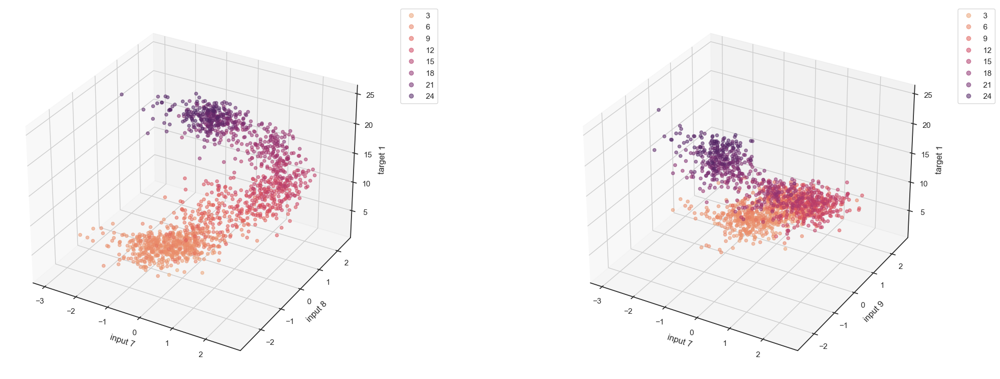

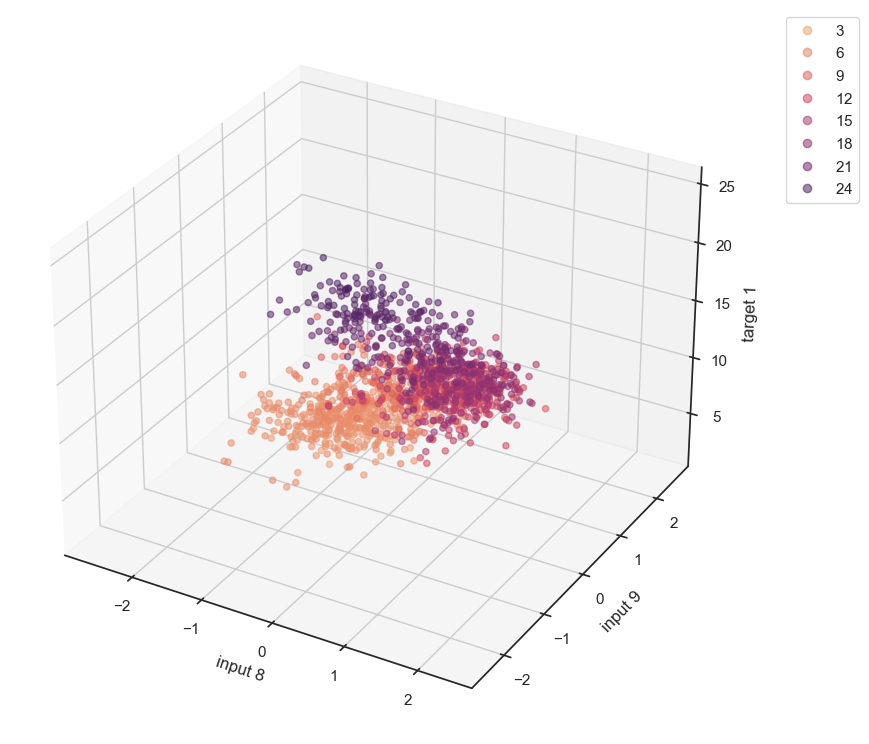

<Figure size 4000x3200 with 0 Axes>

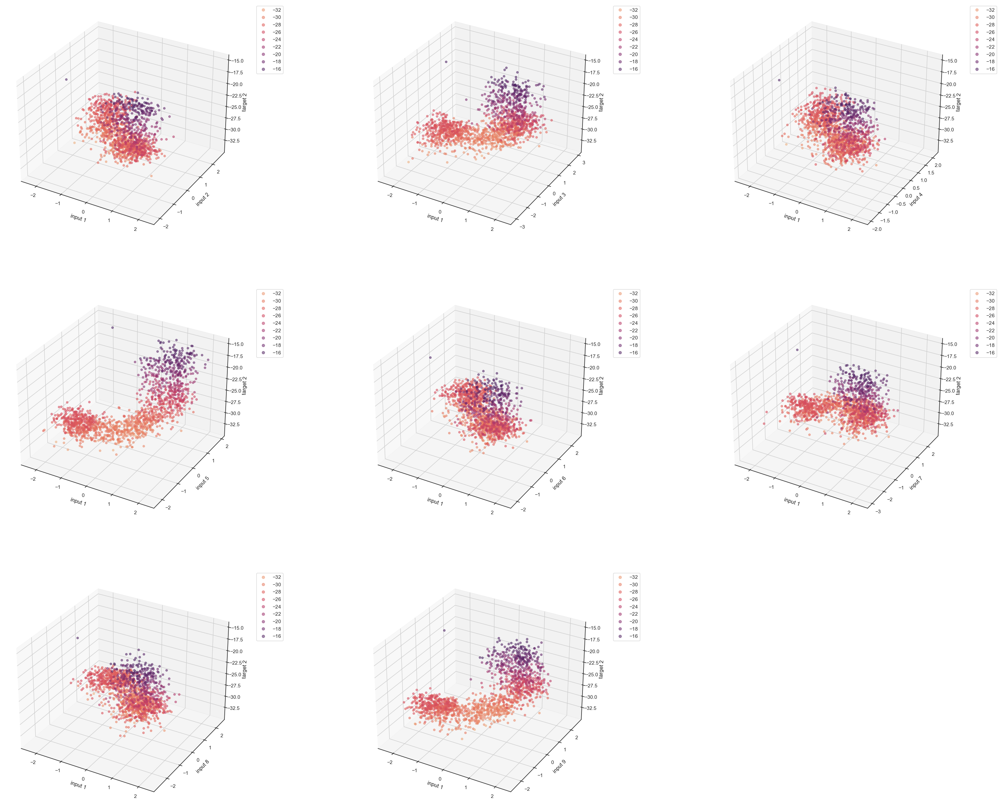

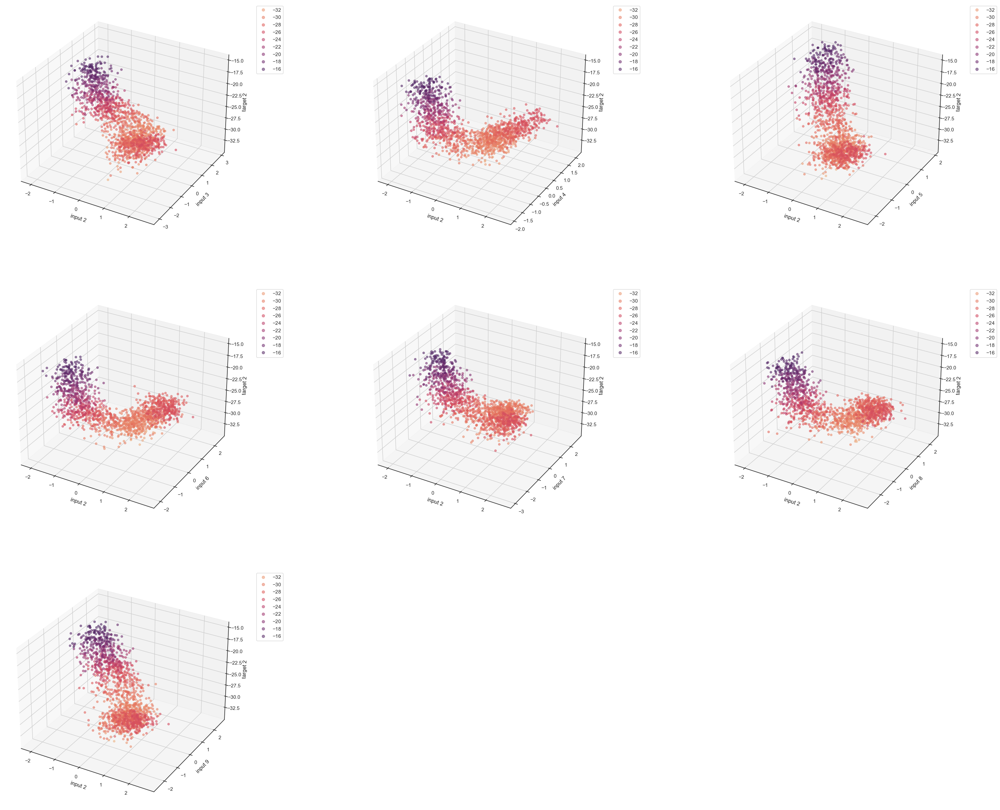

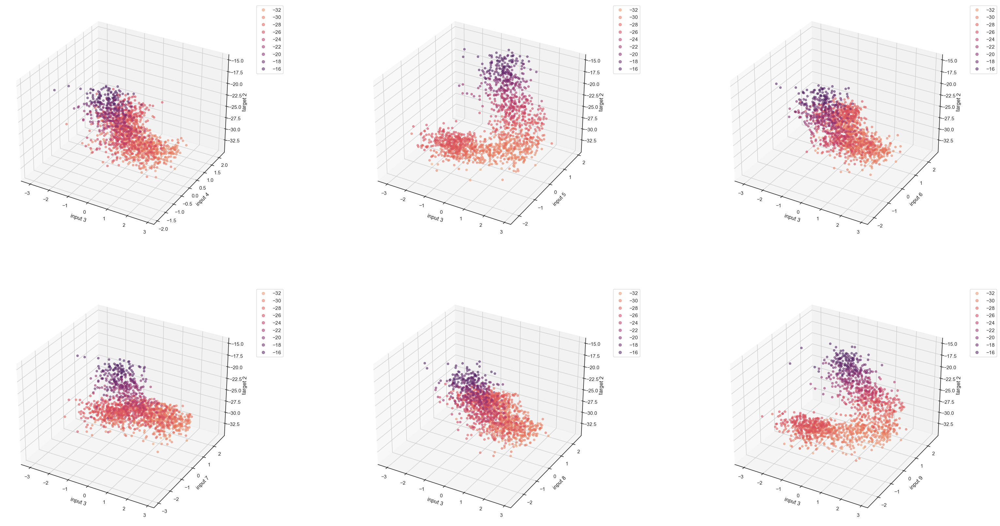

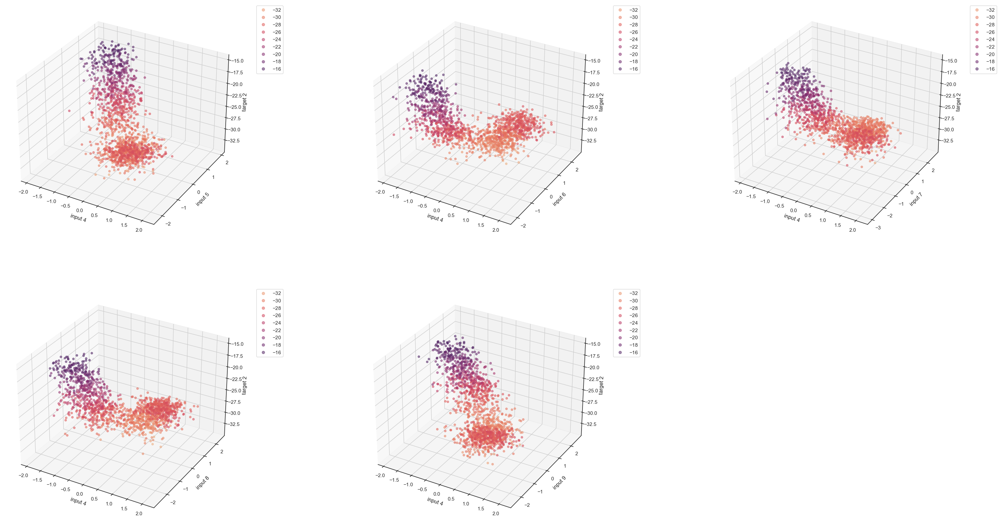

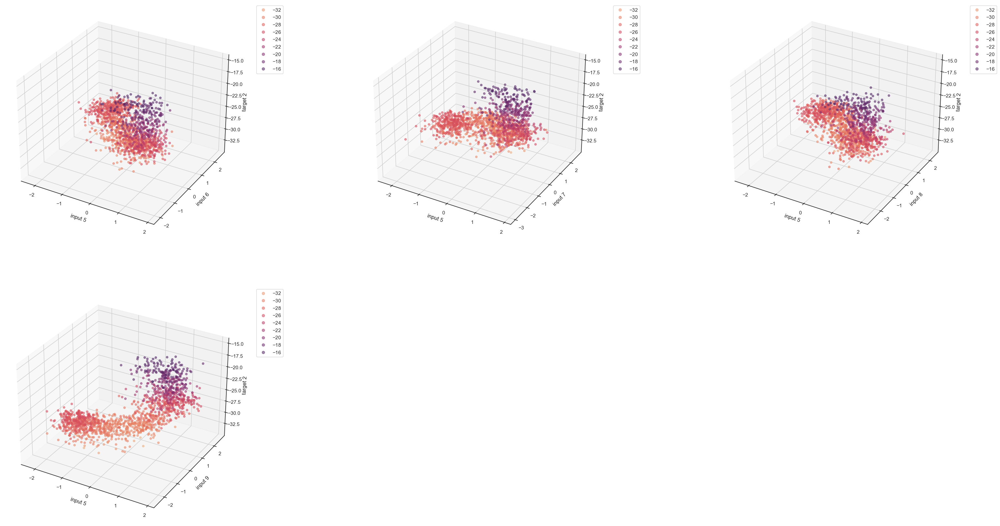

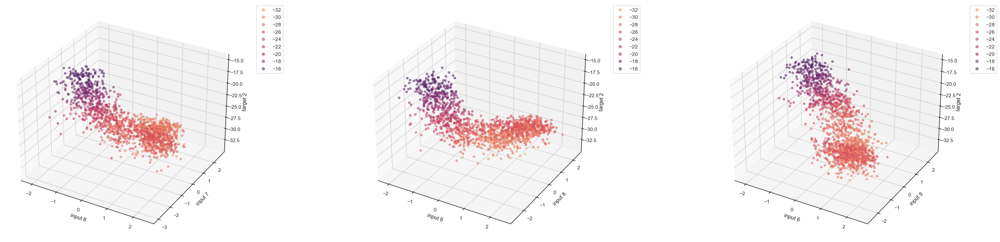

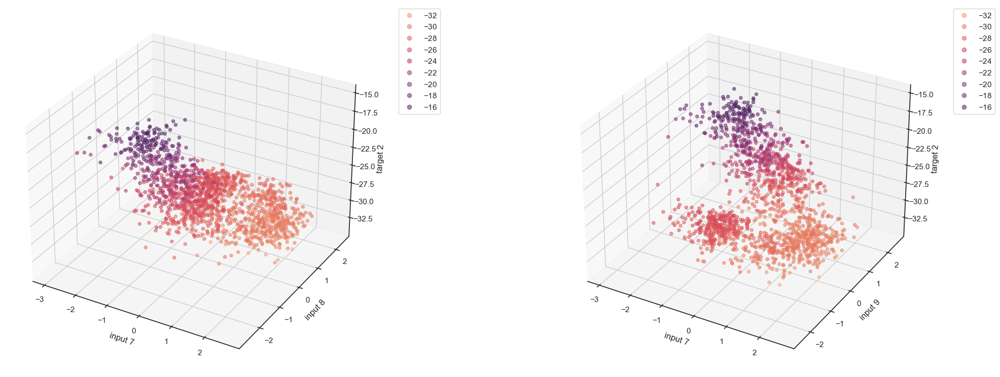

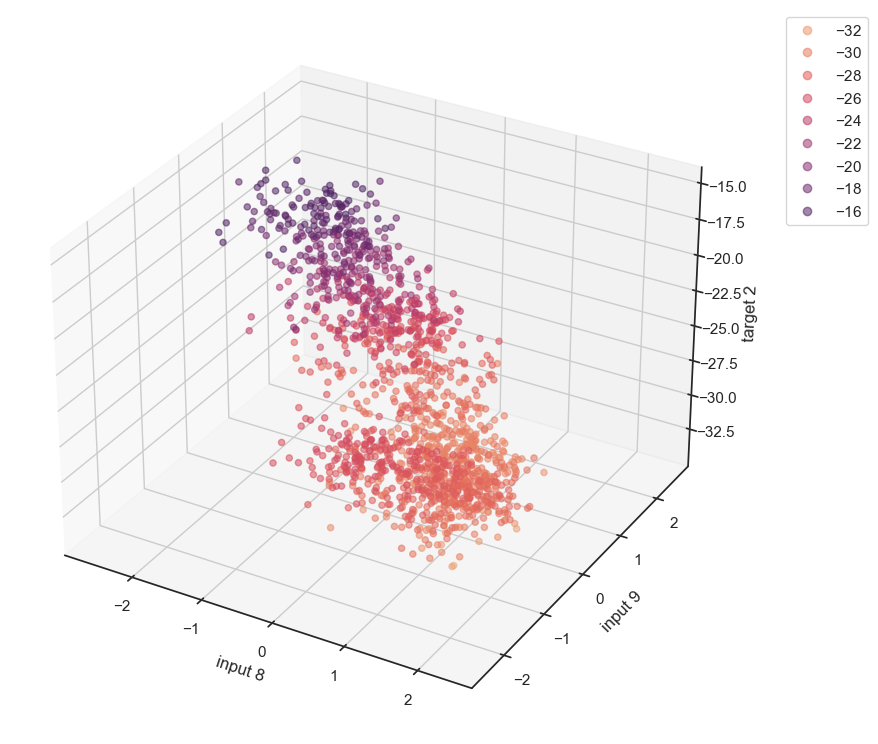

<Figure size 4000x3200 with 0 Axes>

In [39]:
# 3D plots of each pair of inputs respectively for target 1 and 2

sns.set(rc={'figure.figsize':(40,32)})
sns.set(style = "ticks")
cmap = ListedColormap(sns.color_palette("flare", 1000).as_hex())

for j in range(1, 10):
    fig = plt.figure()
    o = 1
    for i in range(1,10):
        if i > j:
            ax = fig.add_subplot(3,3,o, projection = '3d')
    
            inpi_ = 'input_' + str(i)
            inpj_ = 'input_' + str(j)
            x = tvs[inpj_]
            y = tvs[inpi_]
            z = tvs['target_1']

            inp_i = 'input ' + str(i)
            inp_j = 'input ' + str(j)
            ax.set_xlabel(inp_j)
            ax.set_ylabel(inp_i)
            ax.set_zlabel("target 1")

            sc = ax.scatter(x, y, z, c=z, marker='o', cmap=cmap, alpha=0.55)
            o += 1

            plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.06, 1), loc=2)

    plt.show()


for j in range(1, 10):
    fig = plt.figure()
    o = 1
    for i in range(1,10):
        if i > j:
            ax = fig.add_subplot(3,3,o, projection = '3d')
    
            inpi_ = 'input_' + str(i)
            inpj_ = 'input_' + str(j)
            x = tvs[inpj_]
            y = tvs[inpi_]
            z = tvs['target_2']

            inp_i = 'input ' + str(i)
            inp_j = 'input ' + str(j)
            ax.set_xlabel(inp_j)
            ax.set_ylabel(inp_i)
            ax.set_zlabel("target 2")

            sc = ax.scatter(x, y, z, c=z, marker='o', cmap=cmap, alpha=0.55)
            o += 1

            plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.06, 1), loc=2)

    plt.show()

#### Correlations

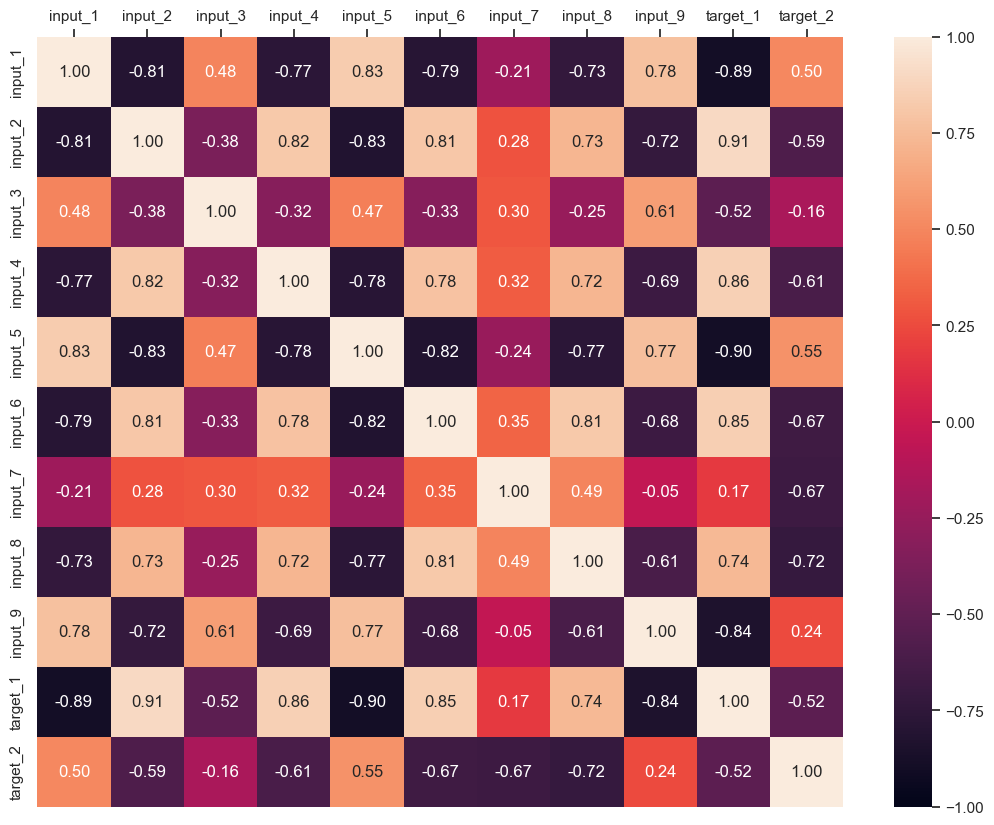

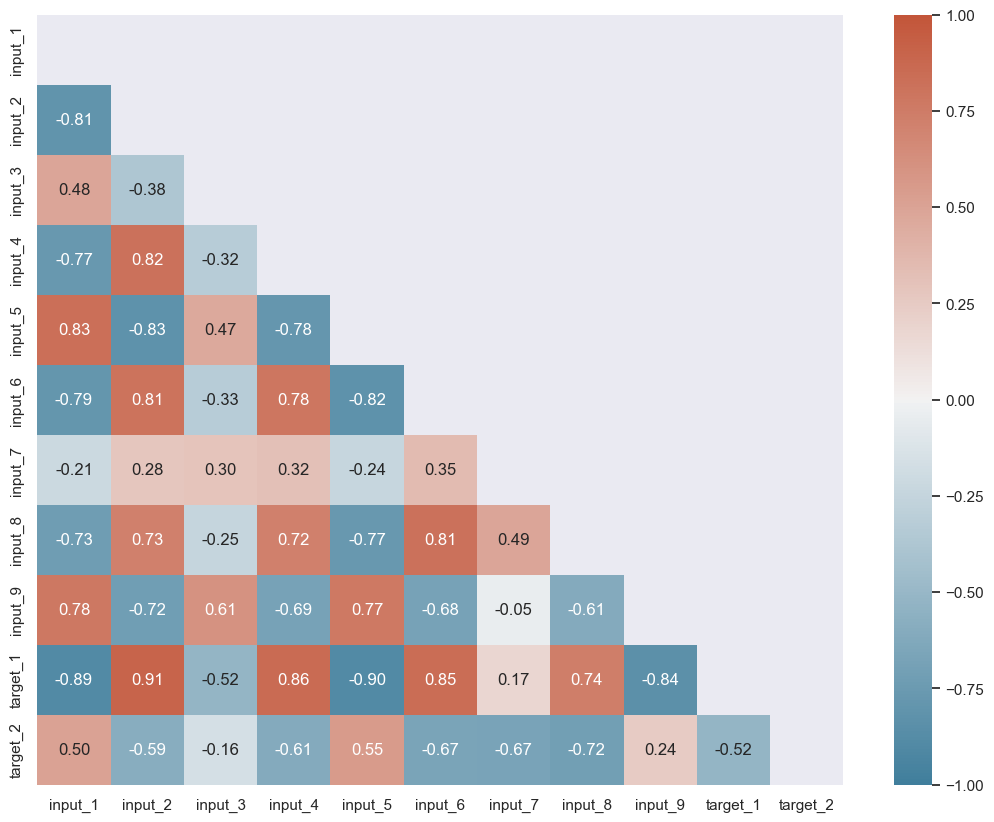

In [40]:
# the correlation heat map representing the correlation matrix (Pearson's correlation coefficient)

sns.set(rc={'figure.figsize':(13,10)})
correlations = tvs.corr()
ax = sns.heatmap(correlations, annot=True, fmt=".2f", vmin=-1., vmax=+1.)
ax.set(xlabel="", ylabel="")
ax.xaxis.tick_top()
plt.show()

# and with mask for the upper triangle

mask = np.triu(np.ones_like(correlations, dtype=bool))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(correlations, annot=True, mask = mask, cmap=cmap, fmt=".2f", vmin=-1., vmax=+1.)
plt.show()

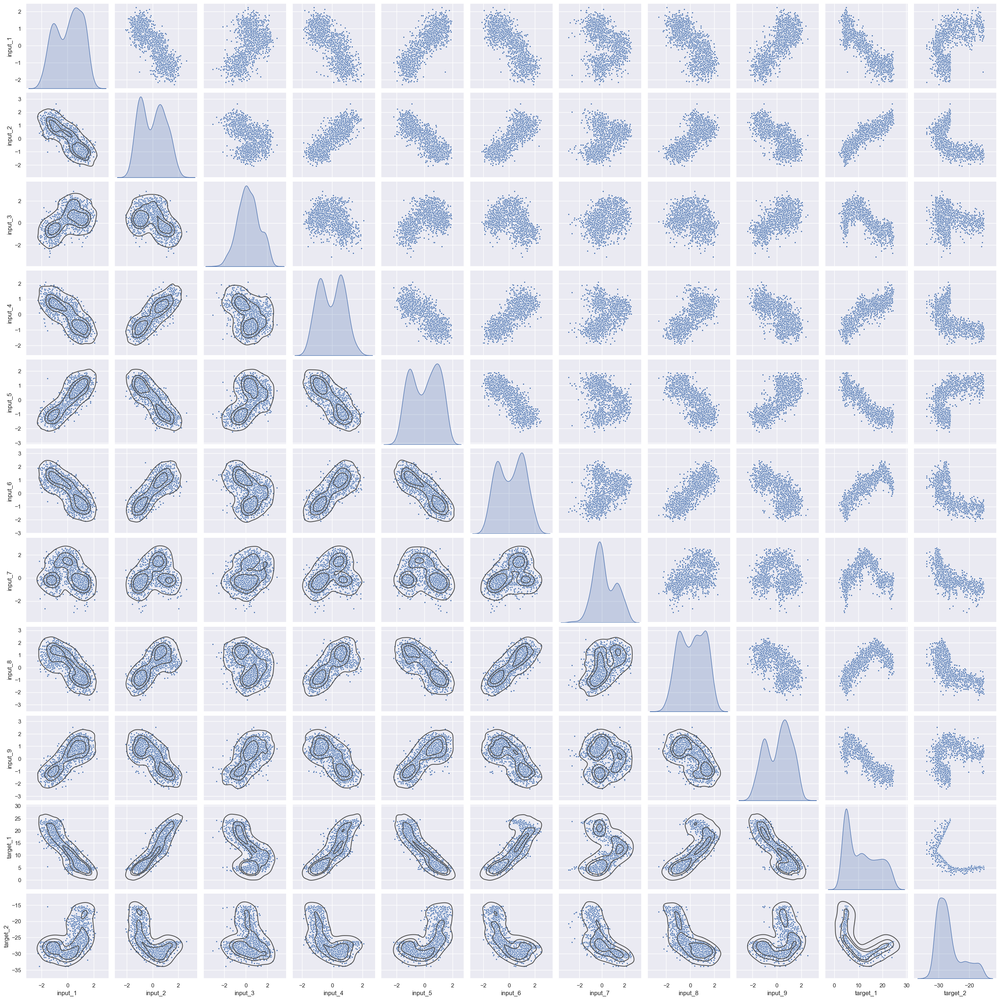

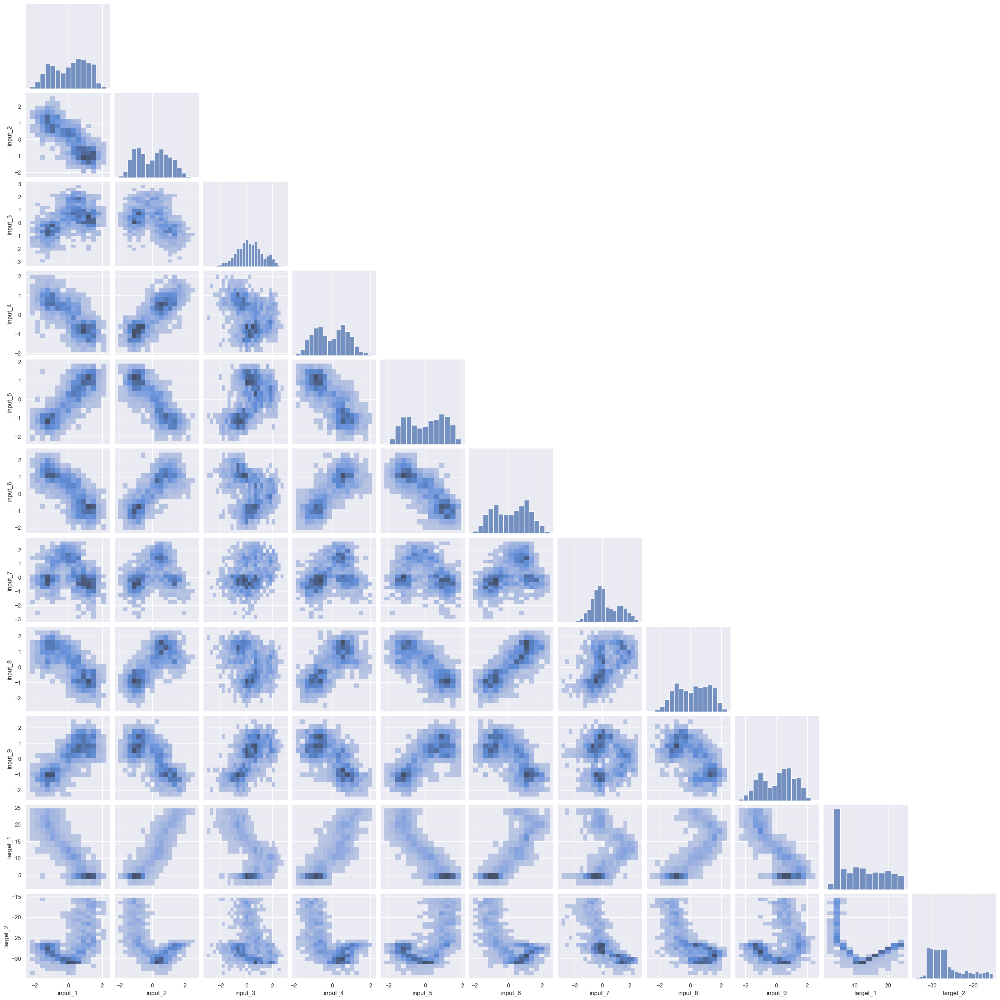

In [41]:
# scatter plots to visualize correlations between inputs
g = sns.pairplot(tvs, markers='.', diag_kind='kde')
g.map_lower(sns.kdeplot, levels=4, color='.3')
plt.show()

g = sns.pairplot(tvs, kind='hist', corner=True)
plt.show()

#### Search algorithms

In [53]:
# import packages
from itertools import product

# function for the grid search
def gridsearch(dictionary : dict, out_dim : int):
    ''' Function for a sequential search in a space of parameters under
    the form of a dictionary (it must have a key 'layers' indicating 
    possible numbers of hidden layers, a key 'units' indicating 
    possible values for number of units in every layer and a key 
    'eta' indicatign posible values for learning rate).

    Arguments
    ----------
    dictionary : dict
        Dictionary with possible values for network parameters.

    out_dim : int
        Dimension of the output layer (number of units).
    '''

    output = np.empty(0, dtype=dict)

    keys = list(dictionary.keys())
    keys.remove('units')
    for param_set in product(*[dictionary[key] for key in keys]):
        param_dict = {key : params for key, params in zip(keys, param_set)}
        for units in product(dictionary['units'], repeat=int(param_dict['layers'])):
            units = np.array(units)
            output_dict = {'units' : np.append(units, out_dim)}
            output_dict.update(param_dict)
            output_dict['layers'] = output_dict['layers'] + 1
            output = np.append(output, output_dict)

    return output

# function for the random search
def randomsearch(dictionary, out_dim, configurations):
    ''' Function for a stochastic search in a space of parameters under
    the form of a dictionary (it must have a key 'layers' indicating 
    possible numbers of hidden layers, a key 'units' indicating 
    possible values for number of units in every layer and a key 
    'eta' indicatign posible values for learning rate).

    Arguments
    ----------
    dictionary : dict
        Dictionary with possible values for network parameters.

    out_dim : int
        Dimension of the output layer (number of units).

    configurations : int
        Number of different configuration to be generated.
    '''

    output = np.empty(0, dtype=dict)

    keys = list(dictionary.keys())
    keys.remove('units')
    for index in range(configurations):
        param_dict = dict()
        for key in keys:
            param_dict[key] = np.random.choice(dictionary[key])
        param_dict['units'] = np.random.choice(dictionary['units'], param_dict['layers'])
        param_dict['units'] = np.append(param_dict['units'], out_dim)
        param_dict['layers'] = param_dict['layers'] + 1
        output = np.append(output, param_dict)

    return output

In [57]:
X_train = [array[1:9] for array in tvs_array]
y_train = [array[10:] for array in tvs_array] 

search_space_dict = {
    'layers' : np.array([1, 2, 3]),
    'units' : np.array([2, 5, 8]),
    'eta' : np.array([0.001, 0.01])
}

search_array = gridsearch(search_space_dict, 2)
print(search_array)

[{'units': array([2, 2]), 'layers': 2, 'eta': 0.001}
 {'units': array([5, 2]), 'layers': 2, 'eta': 0.001}
 {'units': array([8, 2]), 'layers': 2, 'eta': 0.001}
 {'units': array([2, 2]), 'layers': 2, 'eta': 0.01}
 {'units': array([5, 2]), 'layers': 2, 'eta': 0.01}
 {'units': array([8, 2]), 'layers': 2, 'eta': 0.01}
 {'units': array([2, 2, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([2, 5, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([2, 8, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([5, 2, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([5, 5, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([5, 8, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([8, 2, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([8, 5, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([8, 8, 2]), 'layers': 3, 'eta': 0.001}
 {'units': array([2, 2, 2]), 'layers': 3, 'eta': 0.01}
 {'units': array([2, 5, 2]), 'layers': 3, 'eta': 0.01}
 {'units': array([2, 8, 2]), 'layers': 3, 'eta': 0.01}
 {'units': array

In [44]:
from training import train, feedforward_train, backprop_train, reset_mini_batch

for params in search_array:
    print(f'Attempt with layers and units: {params}')
    train(X_train[:50], y_train[:50], eta=params['eta'], num_layers=params['layers'], units_per_layer=params['units'], epochs=10)

Attempt with layers and units: {'units': array([2, 2]), 'layers': 2, 'eta': 0.001}
[ 22.222923 -27.036774] [0.46692988 0.72585119] 622.0432970534293
[ 18.88552 -28.37744] [0.35467206 0.578483  ] 590.9189011299152
[  4.587627 -18.507566] [0.77027512 1.07411179] 199.0071402880531
[ 10.25682  -30.017064] [0.52561805 0.77323737] 521.3694749421967
[  4.916182 -17.67003 ] [0.72316261 0.98685762] 182.8304336378502
[  5.032122 -18.65942 ] [0.78696878 1.02672209] 202.78275812533968
[  9.457703 -28.961837] [0.51048007 0.72320887] 480.6273732702176
[  3.796182 -23.274237] [0.71655815 0.8976103 ] 296.881142532206
[ 13.802171 -30.086104] [0.64816053 0.79209328] 563.2455293559625
[ 20.396121 -28.202145] [0.50475076 0.61853396] 613.1490730722978
[ 22.276608 -26.972735] [0.52731327 0.67069236] 618.595448745847
[  5.081836 -15.556685] [0.76781651 0.84597071] 143.82893932675395
[  5.260284 -26.284435] [0.73440324 0.83295446] 377.91820386757513
[  3.914464 -22.084348] [0.84665807 0.8943926 ] 268.71697646